In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/src/RAW.zip

Archive:  /content/drive/MyDrive/src/RAW.zip
  inflating: IMG_4524.MOV            
  inflating: IMG_4525.MOV            
  inflating: IMG_4534.MOV            
  inflating: IMG_4535.MOV            
  inflating: IMG_4536.MOV            
  inflating: IMG_4537.MOV            
  inflating: IMG_4538.MOV            
  inflating: IMG_4539.MOV            
  inflating: IMG_4540.MOV            
  inflating: IMG_4541.MOV            
  inflating: IMG_4542.MOV            
  inflating: IMG_4543.MOV            
  inflating: IMG_4544.MOV            
  inflating: IMG_4545.MOV            
  inflating: IMG_4546.MOV            
  inflating: IMG_4547.MOV            
  inflating: IMG_4548.MOV            
  inflating: IMG_4549.MOV            
  inflating: IMG_4550.MOV            
  inflating: IMG_4551.MOV            
  inflating: IMG_4552.MOV            
  inflating: IMG_4553.MOV            
  inflating: IMG_4554.MOV            
  inflating: IMG_4555.MOV            
  inflating: IMG_4556.MOV            
  inf

In [ ]:
!pip install opencv-python

In [ ]:
## 반응형 슬라이더 + HSV 색상 추출(H만 조정)
import cv2
import numpy as np
from google.colab import files
from IPython.display import display, clear_output
from ipywidgets import interact, widgets
from PIL import Image as PILImage

# 동영상 파일명
video_filename = "IMG_4553.MOV"

# 비디오 열기
cap = cv2.VideoCapture(video_filename)
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
ret, raw_frame = cap.read()

# 반응형 슬라이더 위젯 생성
lower_hue_slider = widgets.IntSlider(min=0, max=255, value=0, description='Lower Hue')
upper_hue_slider = widgets.IntSlider(min=0, max=255, value=100, description='Upper Hue')

# 슬라이더 값 변경 시 호출되는 콜백 함수 정의
def slider_callback(lower_hue, upper_hue):
    frame = raw_frame.copy()

    # 이미지 자르기
    x1 = int(frame_width * 0.0)
    x2 = int(frame_width * 1.0)
    y1 = int(frame_height * 0.12)
    y2 = int(frame_height * 0.76)
    frame = frame[y1:y2, x1:x2]

    if ret:
        clear_output(wait=True)

        # 변경된 슬라이더 값에 따라 색상 범위 조정
        lower_color = np.array([lower_hue, 0, 20])
        upper_color = np.array([upper_hue, 100, 128])

        # 색상 공간 변환 (BGR -> HSV)
        hsv_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

        # 색상 범위에 해당하는 영역 추출
        color_mask = cv2.inRange(hsv_frame, lower_color, upper_color)

        # 추출된 영역의 좌표 찾기
        contours, _ = cv2.findContours(color_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        for contour in contours:
            area = cv2.contourArea(contour)
            x, y, w, h = cv2.boundingRect(contour)
            cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)
            cv2.putText(frame, f"Area: {area:.2f}", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0, 255, 0), 2)

        # 추출된 색상의 바이너리 마스크와 실제 프레임을 함께 표시
        combined = np.hstack((frame, cv2.cvtColor(color_mask, cv2.COLOR_GRAY2BGR)))

        # 이미지를 iPython Image로 변환하고 표시
        combined_img = cv2.cvtColor(combined, cv2.COLOR_BGR2RGB)
        pil_img = PILImage.fromarray(combined_img)
        pil_img = pil_img.resize((800, 600))  # 이미지 크기 조절
        img_widget = widgets.Image(value=pil_img._repr_png_(), format='png')
        display(img_widget, display_id='image_display', display_id_size=(4, 3))

# interact를 사용하여 슬라이더 위젯과 콜백 함수를 연결
interact(slider_callback, lower_hue=lower_hue_slider, upper_hue=upper_hue_slider)

cap.release()
cv2.destroyAllWindows()

interactive(children=(IntSlider(value=0, description='Lower Hue', max=255), IntSlider(value=100, description='…

In [ ]:
## 색상 지정 & 해당 값의 rgb => HSV 변환하고, 민감도만 조정
import cv2
import numpy as np
from google.colab import files
from IPython.display import display, clear_output
from ipywidgets import interact, widgets
from PIL import Image as PILImage

# 동영상 파일명
video_filename = "IMG_4553.MOV"

# 비디오 열기
cap = cv2.VideoCapture(video_filename)
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
ret, raw_frame = cap.read()

# 슬라이더 값 변경 시 호출되는 콜백 함수 정의
def slider_callback(tolerance):
    frame = raw_frame.copy()

    # 이미지 자르기
    x1 = int(frame_width * 0.0)
    x2 = int(frame_width * 1.0)
    y1 = int(frame_height * 0.12)
    y2 = int(frame_height * 0.76)
    frame = frame[y1:y2, x1:x2]

    if ret:
        clear_output(wait=True)

        # 추출할 색상 목록
        colors = np.array([[27, 37, 34],  # #1B2522
                        [157, 131, 112],  # #9D8370
                        [50, 98, 110]])  # #32626E

        # RGB 색상을 HSV로 변환하는 함수
        def rgb_to_hsv(rgb):
            return cv2.cvtColor(np.uint8([[rgb]]), cv2.COLOR_RGB2HSV)[0][0]

        # 윤곽선 추출을 위한 마스크 생성
        mask = np.zeros(frame.shape[:2], dtype=np.uint8)
        for color in colors:
            # HSV로 변환된 색상 범위 정의
            lower_bound = rgb_to_hsv(color) - [tolerance, 50, 30]
            upper_bound = rgb_to_hsv(color) + [tolerance, 50, 30]
            mask = cv2.bitwise_or(mask, cv2.inRange(frame, lower_bound, upper_bound))

            # 추출된 영역의 좌표 찾기
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

            for contour in contours:
                area = cv2.contourArea(contour)
                if area > 350 and area < 600:
                    x, y, w, h = cv2.boundingRect(contour)
                    cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)
                    cv2.putText(frame, f"Area: {area:.2f}", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 2)

        # 추출된 색상의 바이너리 마스크와 실제 프레임을 함께 표시
        result_frame = cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR)
        cv2.drawContours(result_frame, contours, -1, (0, 255, 0), 2)
        combined = np.hstack([frame, cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR), result_frame])
        # combined = np.hstack([frame, cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR)])

        # 이미지를 iPython Image로 변환하고 표시
        combined_img = cv2.cvtColor(combined, cv2.COLOR_BGR2RGB)
        pil_img = PILImage.fromarray(combined_img).resize((1200, 600))
        img_widget = widgets.Image(value=pil_img._repr_png_(), format='png')
        display(img_widget)

# 반응형 슬라이더 위젯 생성
tolerance_slider = widgets.IntSlider(min=0, max=255, value=30, description='Tolerance')

# interact를 사용하여 슬라이더 위젯과 콜백 함수를 연결
interact(slider_callback, tolerance=tolerance_slider)

cap.release()
cv2.destroyAllWindows()

interactive(children=(IntSlider(value=30, description='Tolerance', max=255), Output()), _dom_classes=('widget-…

In [ ]:
## 동영상으로 맵핑
import cv2
import numpy as np
from google.colab import files
from IPython.display import display, clear_output, HTML, Video
from ipywidgets import interact, widgets
from PIL import Image as PILImage
import os, io, base64

# 동영상 파일명
video_filename = "IMG_4553.MOV"

# 비디오 열기
cap = cv2.VideoCapture(video_filename)
ret, raw_frame = cap.read()

# 반응형 슬라이더 위젯 생성
lower_hue_slider = widgets.IntSlider(min=0, max=255, value=0, description='Lower Hue')
upper_hue_slider = widgets.IntSlider(min=0, max=255, value=100, description='Upper Hue')

# 슬라이더 값 변경 시 호출되는 콜백 함수 정의
def slider_callback(lower_hue, upper_hue):
    cap = cv2.VideoCapture(video_filename)

    # 비디오 정보 가져오기
    frame_width = int(cap.get(3)) * 2
    frame_height = int(cap.get(4))
    # fps = int(cap.get(5))
    fps = 2
    print(f"fps: {fps}")

    # 결과 동영상 저장을 위한 설정
    output_filename = "output_video2.mp4"
    output_codec = cv2.VideoWriter_fourcc(*'mp4v')
    output_video = cv2.VideoWriter(output_filename, output_codec, fps, (frame_width, frame_height))
    # clear_output(wait=True)

    ret = True
    cnt = 0
    while ret:
        ret = cap.set(cv2.CAP_PROP_POS_FRAMES, cnt)
        ret, raw_frame = cap.read()
        if ret:
            frame = raw_frame.copy()

            # 변경된 슬라이더 값에 따라 색상 범위 조정
            lower_color = np.array([lower_hue, 0, 100])
            upper_color = np.array([upper_hue, 100, 255])

            # 색상 공간 변환 (BGR -> HSV)
            hsv_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

            # 색상 범위에 해당하는 영역 추출
            color_mask = cv2.inRange(hsv_frame, lower_color, upper_color)

            # 추출된 영역의 좌표 찾기
            contours, _ = cv2.findContours(color_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

            for contour in contours:
                area = cv2.contourArea(contour)
                x, y, w, h = cv2.boundingRect(contour)
                cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)
                cv2.putText(frame, f"Area: {area:.2f}", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

            # 추출된 색상의 바이너리 마스크와 실제 프레임을 함께 표시
            combined = np.hstack((frame, cv2.cvtColor(color_mask, cv2.COLOR_GRAY2BGR)))
            output_video.write(combined)
        cnt += 120
        print("\r", cnt, end="...",)


    # 결과 동영상 표시
    output_video.release()

    comp_filename = "output_video2_conv.mp4"

    # Compressed video path
    os.system(f"ffmpeg -i {output_filename} -vcodec libx264 {comp_filename}")

    # Show video
    mp4 = open(comp_filename,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    display(HTML("""
    <video width=800 controls>
        <source src="%s" type="video/mp4">
    </video>
    """ % data_url))

# interact를 사용하여 슬라이더 위젯과 콜백 함수를 연결
interact(slider_callback, lower_hue=lower_hue_slider, upper_hue=upper_hue_slider)

cap.release()
# cv2.destroyAllWindows()

interactive(children=(IntSlider(value=0, description='Lower Hue', max=255), IntSlider(value=100, description='…

In [ ]:
!sudo apt install ffmpeg libopencv-dev libgtk-3-dev libjpeg-dev libtiff5-dev libavcodec-dev libavformat-dev libswscale-dev libxine2-dev libgstreamer1.0-dev libgstreamer-plugins-base1.0-dev libv4l-dev libtbb-dev qtbase5-dev libfaac-dev libmp3lame-dev libopencore-amrnb-dev libopencore-amrwb-dev libtheora-dev libvorbis-dev libxvidcore-dev x264 v4l-utils unzip

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
libjpeg-dev is already the newest version (8c-2ubuntu10).
libjpeg-dev set to manually installed.
libvorbis-dev is already the newest version (1.3.7-1build2).
libvorbis-dev set to manually installed.
libopencv-dev is already the newest version (4.5.4+dfsg-9ubuntu4).
libtbb-dev is already the newest version (2021.5.0-7ubuntu2).
libtbb-dev set to manually installed.
unzip is already the newest version (6.0-26ubuntu3.1).
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
libavcodec-dev is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
libavcodec-dev set to manually installed.
libavformat-dev is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
libavformat-dev set to manually installed.
libswscale-dev is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
libswscale-dev set to manually installed.
The following additional packages will be installed:
  gir1.2-atk-1.0 

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
input_filename = "output_video2.mp4"

# Compressed video path
compressed_filename = "output_video2_compressed.mp4"

os.system(f"ffmpeg -i {input_filename} -vcodec libx264 {compressed_filename}")

# Show video
mp4 = open(compressed_filename, 'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
display(HTML("""
<video width=800 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url))

In [ ]:
import cv2
import numpy as np
import csv

# 입력 동영상 경로
input_filename = "/content/output_video2.mp4"  # 원본 동영상 파일 경로 입력

# 입력 동영상 로드
cap = cv2.VideoCapture(input_filename)
frame_rate = cap.get(cv2.CAP_PROP_FPS)
frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))  # 프레임 수

# 파란색과 갈색 범위 정의
blue_range = {
    'lower': np.array([100, 50, 50]),  # 파란색 범위 수정
    'upper': np.array([140, 255, 255])  # 파란색 범위 수정
}

brown_range = {
    'lower': np.array([0, 70, 70]),  # 갈색 범위 수정
    'upper': np.array([30, 255, 255])  # 갈색 범위 수정
}

# CSV 파일 생성
csv_filename = "color_coordinates.csv"
with open(csv_filename, 'w', newline='') as csvfile:
    csvwriter = csv.writer(csvfile)
    csvwriter.writerow(['time', 'x_blue', 'y_blue', 'x_brown', 'y_brown'])

    for frame_index in range(frame_count):
        ret, frame = cap.read()
        if not ret:
            break

        # BGR 프레임을 HSV로 변환
        hsv_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

        # 파란색과 갈색 영역 추출
        blue_mask = cv2.inRange(hsv_frame, blue_range['lower'], blue_range['upper'])
        brown_mask = cv2.inRange(hsv_frame, brown_range['lower'], brown_range['upper'])

        # 파란색과 갈색 영역의 윤곽선 찾기
        blue_contours, _ = cv2.findContours(blue_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        brown_contours, _ = cv2.findContours(brown_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # x, y 좌표 초기화
        x_blue, y_blue = -1, -1
        x_brown, y_brown = -1, -1

        # 가장 큰 윤곽선 찾기
        if blue_contours:
            blue_contour = max(blue_contours, key=cv2.contourArea)
            M = cv2.moments(blue_contour)
            if M["m00"] != 0:
                x_blue = int(M["m10"] / M["m00"])
                y_blue = int(M["m01"] / M["m00"])

        if brown_contours:
            brown_contour = max(brown_contours, key=cv2.contourArea)
            M = cv2.moments(brown_contour)
            if M["m00"] != 0:
                x_brown = int(M["m10"] / M["m00"])
                y_brown = int(M["m01"] / M["m00"])

        # 데이터를 CSV 파일에 기록
        time_in_seconds = frame_index / frame_rate
        csvwriter.writerow([int(time_in_seconds), x_blue, y_blue, x_brown, y_brown])

cap.release()

print("CSV 파일이 생성되었습니다:", csv_filename)

CSV 파일이 생성되었습니다: color_coordinates.csv


In [ ]:
import cv2
import numpy as np
import csv

# 입력 동영상 경로
input_filename = "/content/output_video2.mp4"  # 원본 동영상 파일 경로 입력

# 입력 동영상 로드
cap = cv2.VideoCapture(input_filename)
frame_rate = cap.get(cv2.CAP_PROP_FPS)
frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))  # 프레임 수

# 초록색 범위 정의
green_range = {
    'lower': np.array([35, 70, 70]),  # 초록색 범위 조정
    'upper': np.array([85, 255, 255])  # 초록색 범위 조정
}

# 파란색과 갈색 범위 정의
blue_range = {
    'lower': np.array([100, 50, 50]),  # 파란색 범위 수정
    'upper': np.array([140, 255, 255])  # 파란색 범위 수정
}

brown_range = {
    'lower': np.array([0, 70, 70]),  # 갈색 범위 수정
    'upper': np.array([30, 255, 255])  # 갈색 범위 수정
}

# CSV 파일 생성
csv_filename = "color_coordinates.csv"
with open(csv_filename, 'w', newline='') as csvfile:
    csvwriter = csv.writer(csvfile)
    csvwriter.writerow(['time', 'x_blue', 'y_blue', 'x_brown', 'y_brown'])

    for frame_index in range(frame_count):
        ret, frame = cap.read()
        if not ret:
            break

        # BGR 프레임을 HSV로 변환
        hsv_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

        # 초록색 영역 추출
        green_mask = cv2.inRange(hsv_frame, green_range['lower'], green_range['upper'])
        green_contours, _ = cv2.findContours(green_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # 초록색 영역 내에서 파란색과 갈색 영역 추출
        if green_contours:
            green_contour = max(green_contours, key=cv2.contourArea)
            x, y, w, h = cv2.boundingRect(green_contour)

            green_frame = green_mask[y:y+h, x:x+w]
            blue_mask = cv2.inRange(hsv_frame[y:y+h, x:x+w], blue_range['lower'], blue_range['upper'])
            brown_mask = cv2.inRange(hsv_frame[y:y+h, x:x+w], brown_range['lower'], brown_range['upper'])

            blue_contours, _ = cv2.findContours(blue_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            brown_contours, _ = cv2.findContours(brown_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

            x_blue, y_blue = -1, -1
            x_brown, y_brown = -1, -1

            if blue_contours:
                blue_contour = max(blue_contours, key=cv2.contourArea)
                M = cv2.moments(blue_contour)
                if M["m00"] != 0:
                    x_blue = int(M["m10"] / M["m00"])
                    y_blue = int(M["m01"] / M["m00"])

            if brown_contours:
                brown_contour = max(brown_contours, key=cv2.contourArea)
                M = cv2.moments(brown_contour)
                if M["m00"] != 0:
                    x_brown = int(M["m10"] / M["m00"])
                    y_brown = int(M["m01"] / M["m00"])

            # 데이터를 CSV 파일에 기록
            time_in_seconds = frame_index / frame_rate
            csvwriter.writerow([int(time_in_seconds), x_blue, y_blue, x_brown, y_brown])

cap.release()

print("CSV 파일이 생성되었습니다:", csv_filename)

CSV 파일이 생성되었습니다: color_coordinates.csv


In [ ]:
import cv2
import numpy as np
from google.colab import files
from IPython.display import display, clear_output
from ipywidgets import interact, widgets
from PIL import Image as PILImage

# 동영상 파일명
video_filename = "IMG_4553.MOV"

# 비디오 열기
cap = cv2.VideoCapture(video_filename)
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
ret, raw_frame = cap.read()

# 슬라이더 값 변경 시 호출되는 콜백 함수 정의
def slider_callback(tolerance):
    frame = raw_frame.copy()

    # 이미지 자르기
    x1 = int(frame_width * 0.0)
    x2 = int(frame_width * 1.0)
    y1 = int(frame_height * 0.12)
    y2 = int(frame_height * 0.76)
    frame = frame[y1:y2, x1:x2]

    if ret:
        clear_output(wait=True)

        # 추출할 색상 목록
        colors = np.array([[27, 37, 34],  # #1B2522
                        [157, 131, 112],  # #9D8370
                        [50, 98, 110]])  # #32626E

        # RGB 색상을 HSV로 변환하는 함수
        def rgb_to_hsv(rgb):
            return cv2.cvtColor(np.uint8([[rgb]]), cv2.COLOR_RGB2HSV)[0][0]

        # 윤곽선 추출을 위한 마스크 생성
        mask = np.zeros(frame.shape[:2], dtype=np.uint8)
        for color in colors:
            # HSV로 변환된 색상 범위 정의
            lower_bound = rgb_to_hsv(color) - [tolerance, 50, 30]
            upper_bound = rgb_to_hsv(color) + [tolerance, 50, 30]
            mask = cv2.bitwise_or(mask, cv2.inRange(frame, lower_bound, upper_bound))

        # 추출된 영역의 좌표 찾기
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        for contour in contours:
            area = cv2.contourArea(contour)
            if area > 350 and area < 600:
                x, y, w, h = cv2.boundingRect(contour)
                cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)
                cv2.putText(frame, f"Area: {area:.2f}", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 2)

        # 이미지를 iPython Image로 변환하고 표시
        combined_img = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        pil_img = PILImage.fromarray(combined_img).resize((1200, 600))
        img_widget = widgets.Image(value=pil_img._repr_png_(), format='png')
        display(img_widget)

# 반응형 슬라이더 위젯 생성
tolerance_slider = widgets.IntSlider(min=0, max=255, value=30, description='Tolerance')

# interact를 사용하여 슬라이더 위젯과 콜백 함수를 연결
interact(slider_callback, tolerance=tolerance_slider)

cap.release()
cv2.destroyAllWindows()

# 입력 동영상 경로
input_filename = "/content/output_video2.mp4"  # 원본 동영상 파일 경로 입력

# 입력 동영상 로드
cap = cv2.VideoCapture(input_filename)
frame_rate = cap.get(cv2.CAP_PROP_FPS)
frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))  # 프레임 수

# 초록색 범위 정의
green_range = {
    'lower': np.array([35, 70, 70]),  # 초록색 범위 조정
    'upper': np.array([85, 255, 255])  # 초록색 범위 조정
}

# 파란색과 갈색 범위 정의
blue_range = {
    'lower': np.array([100, 50, 50]),  # 파란색 범위 수정
    'upper': np.array([140, 255, 255])  # 파란색 범위 수정
}

brown_range = {
    'lower': np.array([0, 70, 70]),  # 갈색 범위 수정
    'upper': np.array([30, 255, 255])  # 갈색 범위 수정
}

# CSV 파일 생성
csv_filename = "color_coordinates.csv"
with open(csv_filename, 'w', newline='') as csvfile:
    csvwriter = csv.writer(csvfile)
    csvwriter.writerow(['time', 'x_blue', 'y_blue', 'x_brown', 'y_brown'])

    for frame_index in range(frame_count):
        ret, frame = cap.read()
        if not ret:
            break

        # BGR 프레임을 HSV로 변환
        hsv_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

        # 초록색 영역 추출
        green_mask = cv2.inRange(hsv_frame, green_range['lower'], green_range['upper'])
        green_contours, _ = cv2.findContours(green_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # 초록색 영역 내에서 파란색과 갈색 영역 추출
        if green_contours:
            green_contour = max(green_contours, key=cv2.contourArea)
            x, y, w, h = cv2.boundingRect(green_contour)

            green_frame = green_mask[y:y+h, x:x+w]
            blue_mask = cv2.inRange(hsv_frame[y:y+h, x:x+w], blue_range['lower'], blue_range['upper'])
            brown_mask = cv2.inRange(hsv_frame[y:y+h, x:x+w], brown_range['lower'], brown_range['upper'])

            blue_contours, _ = cv2.findContours(blue_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            brown_contours, _ = cv2.findContours(brown_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

            x_blue, y_blue = -1, -1
            x_brown, y_brown = -1, -1

            if blue_contours:
                blue_contour = max(blue_contours, key=cv2.contourArea)
                M = cv2.moments(blue_contour)
                if M["m00"] != 0:
                    x_blue = int(M["m10"] / M["m00"])
                    y_blue = int(M["m01"] / M["m00"])

            if brown_contours:
                brown_contour = max(brown_contours, key=cv2.contourArea)
                M = cv2.moments(brown_contour)
                if M["m00"] != 0:
                    x_brown = int(M["m10"] / M["m00"])
                    y_brown = int(M["m01"] / M["m00"])

            # 데이터를 CSV 파일에 기록
            time_in_seconds = frame_index / frame_rate
            csvwriter.writerow([int(time_in_seconds), x_blue, y_blue, x_brown, y_brown])

cap.release()

print("CSV 파일이 생성되었습니다:", csv_filename)

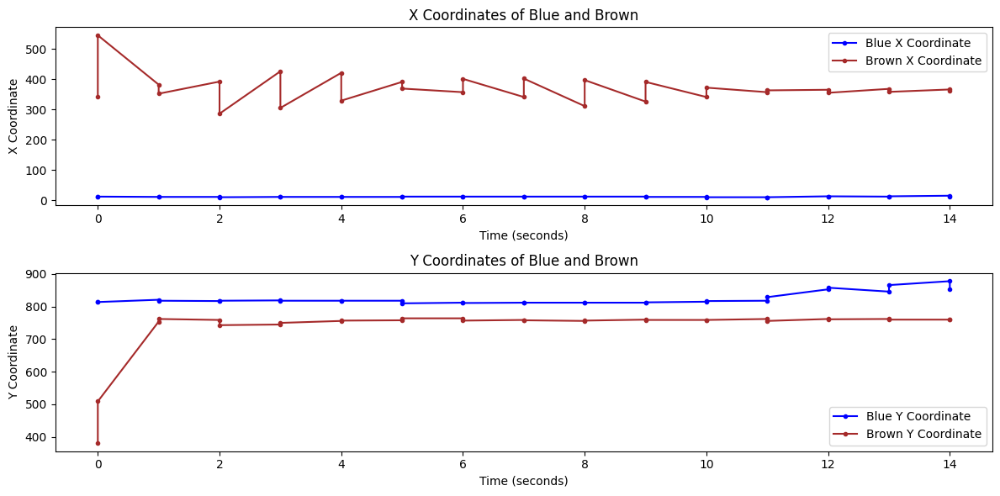

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# CSV 파일 경로
csv_filename = "/content/color_coordinates.csv"

# CSV 파일 읽기
data = pd.read_csv(csv_filename)

# 데이터 검증 및 시각화
plt.figure(figsize=(12, 6))

plt.subplot(2, 1, 1)
# 주석: plt.plot(data['time'], data['x_blue'], label='Blue X Coordinate', color='blue')
plt.plot(data['time'], data['x_blue'], label='Blue X Coordinate', color='blue', marker='o', linestyle='-', markersize=3)
# 주석: plt.plot(data['time'], data['x_brown'], label='Brown X Coordinate', color='brown')
plt.plot(data['time'], data['x_brown'], label='Brown X Coordinate', color='brown', marker='o', linestyle='-', markersize=3)
plt.xlabel('Time (seconds)')
plt.ylabel('X Coordinate')
plt.legend()
plt.title('X Coordinates of Blue and Brown')

plt.subplot(2, 1, 2)
# 주석: plt.plot(data['time'], data['y_blue'], label='Blue Y Coordinate', color='blue')
plt.plot(data['time'], data['y_blue'], label='Blue Y Coordinate', color='blue', marker='o', linestyle='-', markersize=3)
# 주석: plt.plot(data['time'], data['y_brown'], label='Brown Y Coordinate', color='brown')
plt.plot(data['time'], data['y_brown'], label='Brown Y Coordinate', color='brown', marker='o', linestyle='-', markersize=3)
plt.xlabel('Time (seconds)')
plt.ylabel('Y Coordinate')
plt.legend()
plt.title('Y Coordinates of Blue and Brown')

plt.tight_layout()
plt.show()

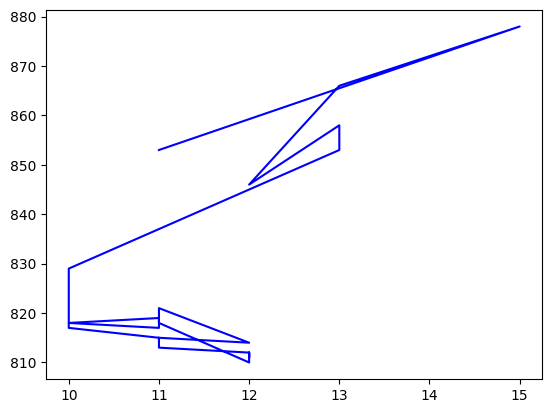

In [ ]:
plt.plot(data['x_blue'], data['y_blue'], label='Blue Y Coordinate', color='blue')

In [ ]:
!pip install opencv-python pandas matplotlib

In [ ]:
# CSV 파일 읽기
data = pd.read_csv(csv_filename)

# 데이터프레임의 컬럼 이름 확인
print(data.columns)

Index(['Time', 'Frame', 'Color', 'X', 'Y'], dtype='object')


In [ ]:
import cv2
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import display, HTML
from base64 import b64encode

# 원본 동영상 파일 경로
video_filename = "/content/drive/MyDrive/src/RAW/IMG_4553.MOV"

# CSV 파일 경로
csv_filename = "/content/color_coordinates.csv"

# 원본 동영상 로드
cap = cv2.VideoCapture(video_filename)
frame_rate = cap.get(cv2.CAP_PROP_FPS)

# CSV 파일 읽기
data = pd.read_csv(csv_filename)

# 동영상 프레임과 데이터를 함께 시각화
fig, ax = plt.subplots(figsize=(10, 6))
line1, = ax.plot(data['Time'], data['X'], label='Blue X Coordinate', color='blue', marker='o', linestyle='-', markersize=3)
line2, = ax.plot(data['Time'], data['Y'], label='Brown X Coordinate', color='red', marker='o', linestyle='-', markersize=3)
ax.set_xlabel('Time (seconds)')
ax.set_ylabel('X Coordinate')
ax.set_title('X Coordinates of Blue and Red')
ax.legend()

# 동영상 프레임을 이미지로 변환하여 표시
def display_frame(frame):
    _, buffer = cv2.imencode('.jpg', frame)
    jpg_data = b64encode(buffer)
    display(HTML(f'<img src="data:image/jpeg;base64,{jpg_data.decode()}" width="600">'))

frame_index = 0
while True:
    ret, frame = cap.read()
    if not ret:
        break

    # 해당 프레임의 데이터 시각화 위치 확인
    if frame_index < len(data):
        color = data.at[frame_index, 'Color']
        x = data.at[frame_index, 'X']
        y = data.at[frame_index, 'Y']

        # Blue와 Brown의 데이터 위치를 프레임에 표시
        if color == 'Blue':
            cv2.circle(frame, (int(x), int(y)), 10, (255, 0, 0), -1)
        elif color == 'Brown':
            cv2.circle(frame, (int(x), int(y)), 10, (0, 0, 255), -1)

        display_frame(frame)
        plt.pause(0.1)

    frame_index += 1

cap.release()
plt.close()

In [ ]:
import cv2
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import display, HTML
from base64 import b64encode

# 원본 동영상 파일 경로
video_filename = "/content/drive/MyDrive/src/RAW/IMG_4553.MOV"

# CSV 파일 경로
csv_filename = "/content/color_coordinates.csv"

# 원본 동영상 로드
cap = cv2.VideoCapture(video_filename)
frame_rate = cap.get(cv2.CAP_PROP_FPS)

# CSV 파일 읽기
data = pd.read_csv(csv_filename)

# 동영상 프레임과 데이터를 함께 시각화
fig, ax = plt.subplots(figsize=(10, 6))
line1, = ax.plot(data['time'], data['x_blue'], label='Blue X Coordinate', color='blue', marker='o', linestyle='-', markersize=3)
line2, = ax.plot(data['time'], data['x_brown'], label='Brown X Coordinate', color='brown', marker='o', linestyle='-', markersize=3)
ax.set_xlabel('Time (seconds)')
ax.set_ylabel('X Coordinate')
ax.set_title('X Coordinates of Blue and Brown')
ax.legend()

# 동영상 프레임을 이미지로 변환하여 표시
def display_frame(frame):
    _, buffer = cv2.imencode('.jpg', frame)
    jpg_data = b64encode(buffer)
    display(HTML(f'<img src="data:image/jpeg;base64,{jpg_data.decode()}" width="600">'))

frame_index = 0
while True:
    ret, frame = cap.read()
    if not ret:
        break

    # 해당 프레임의 데이터 시각화 위치 확인
    if frame_index < len(data):
        color = data.at[frame_index, 'color']
        x = data.at[frame_index, 'x']
        y = data.at[frame_index, 'y']

        # Blue와 Brown의 데이터 위치를 프레임에 표시
        if color == 'Blue':
            cv2.circle(frame, (int(x), int(y)), 10, (255, 0, 0), -1)
        elif color == 'Brown':
            cv2.circle(frame, (int(x), int(y)), 10, (0, 0, 255), -1)

        display_frame(frame)
        plt.pause(0.1)

    frame_index += 1

cap.release()
plt.close()

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# 동영상 파일 열기
video_path = '/content/drive/MyDrive/src/RAW/IMG_4553.MOV'
cap = cv2.VideoCapture(video_path)

while cap.isOpened():
    ret, frame = cap.read()

    if not ret:
        break

    # BGR에서 HSV로 변환
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

    # 녹색 범위 설정
    lower_green = np.array([35, 100, 100])
    upper_green = np.array([85, 255, 255])

    # 녹색 범위에 해당하는 마스크 생성
    mask = cv2.inRange(hsv, lower_green, upper_green)

    # 마스크와 원본 프레임 비트와이즈 AND 연산
    result = cv2.bitwise_and(frame, frame, mask=mask)

    # 윤곽선 검출
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # 검출된 윤곽선을 원본 프레임에 그리기
    cv2.drawContours(frame, contours, -1, (0, 255, 0), 2)

    # 결과 출력
    cv2_imshow(frame)
    cv2_imshow(mask)
    cv2_imshow(result)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# 자원 해제
cap.release()
cv2.destroyAllWindows()
cap = cv2.VideoCapture(video_path)

while cap.isOpened():
    ret, frame = cap.read()

    if not ret:
        break

    # BGR에서 HSV로 변환
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

    # 녹색 범위 설정
    lower_green = np.array([35, 100, 100])
    upper_green = np.array([85, 255, 255])

    # 녹색 범위에 해당하는 마스크 생성
    mask = cv2.inRange(hsv, lower_green, upper_green)

    # 마스크와 원본 프레임 비트와이즈 AND 연산
    result = cv2.bitwise_and(frame, frame, mask=mask)

    # 윤곽선 검출
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # 검출된 윤곽선을 원본 프레임에 그리기
    cv2.drawContours(frame, contours, -1, (0, 255, 0), 2)

    # 결과 출력
    cv2_imshow(frame)
    cv2_imshow(mask)
    cv2_imshow(result)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# 자원 해제
cap.release()
cv2.destroyAllWindows()

In [ ]:
import cv2
import numpy as np
import pandas as pd
import time

# 동영상 파일 열기
video_path = '/content/drive/MyDrive/src/RAW/IMG_4553.MOV'
cap = cv2.VideoCapture(video_path)

# CSV 파일에 저장할 데이터를 담을 리스트
data = []

frame_count = 0

while cap.isOpened():
    ret, frame = cap.read()

    if not ret:
        break

    frame_count += 1

    # BGR에서 HSV로 변환
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

    # 녹색 범위 설정
    lower_green = np.array([35, 100, 100])
    upper_green = np.array([85, 255, 255])

    # 파란색 범위 설정
    lower_blue = np.array([90, 100, 100])
    upper_blue = np.array([130, 255, 255])

    # 갈색 범위 설정
    lower_brown = np.array([10, 60, 60])
    upper_brown = np.array([30, 255, 255])

    # 각 색상에 해당하는 마스크 생성
    mask_green = cv2.inRange(hsv, lower_green, upper_green)
    mask_blue = cv2.inRange(hsv, lower_blue, upper_blue)
    mask_brown = cv2.inRange(hsv, lower_brown, upper_brown)

    # 윤곽선 검출
    contours_green, _ = cv2.findContours(mask_green, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours_blue, _ = cv2.findContours(mask_blue, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours_brown, _ = cv2.findContours(mask_brown, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    current_time = time.strftime("%H:%M:%S", time.localtime())


# 자원 해제
cap.release()
cv2.destroyAllWindows()

KeyboardInterrupt: ignored

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# 동영상 파일 열기
video_path = '/content/drive/MyDrive/src/RAW/IMG_4553.MOV'
cap = cv2.VideoCapture(video_path)

while cap.isOpened():
    ret, frame = cap.read()

    if not ret:
        break

    # BGR에서 HSV로 변환
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

    # 녹색 범위 설정
    lower_green = np.array([35, 100, 100])
    upper_green = np.array([85, 255, 255])

    # 파란색 범위 설정
    lower_blue = np.array([90, 100, 100])
    upper_blue = np.array([130, 255, 255])

    # 갈색 범위 설정
    lower_brown = np.array([10, 60, 60])
    upper_brown = np.array([30, 255, 255])

    # 각 색상에 해당하는 마스크 생성
    mask_green = cv2.inRange(hsv, lower_green, upper_green)
    mask_blue = cv2.inRange(hsv, lower_blue, upper_blue)
    mask_brown = cv2.inRange(hsv, lower_brown, upper_brown)

    # 윤곽선 검출
    contours_green, _ = cv2.findContours(mask_green, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours_blue, _ = cv2.findContours(mask_blue, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours_brown, _ = cv2.findContours(mask_brown, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # 검출된 윤곽선을 원본 프레임에 그리기
    for contour in contours_green:
        x, y, w, h = cv2.boundingRect(contour)
        cx = x + w // 2
        cy = y + h // 2

        # 초록색 윤곽선 영역 내에서 작은 초록색 윤곽선을 그리지 않도록 조정
        if np.any(mask_green[y:y+h, x:x+w] == 255) and w > 20 and h > 20:
            cv2.rectangle(frame, (x - 20, y - 20), (x + w + 20, y + h + 20), (0, 255, 0), 2)
            cv2.circle(frame, (cx, cy), 5, (0, 255, 0), -1)

    for contour in contours_blue:
        x, y, w, h = cv2.boundingRect(contour)
        cx = x + w // 2
        cy = y + h // 2
        cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 0), 2)
        cv2.circle(frame, (cx, cy), 5, (255, 0, 0), -1)

    for contour in contours_brown:
        x, y, w, h = cv2.boundingRect(contour)
        cx = x + w // 2
        cy = y + h // 2
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 0, 255), 2)
        cv2.circle(frame, (cx, cy), 5, (0, 0, 255), -1)

    # 결과 출력
    cv2_imshow(frame)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# 자원 해제
cap.release()
cv2.destroyAllWindows()

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# 동영상 파일 열기
video_path = '/content/drive/MyDrive/src/RAW/IMG_4553.MOV'
cap = cv2.VideoCapture(video_path)

while cap.isOpened():
    ret, frame = cap.read()

    if not ret:
        break

    # BGR에서 HSV로 변환
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

    # 녹색 범위 설정
    lower_green = np.array([35, 100, 100])
    upper_green = np.array([85, 255, 255])

    # 파란색 범위 설정
    lower_blue = np.array([90, 100, 100])
    upper_blue = np.array([130, 255, 255])

    # 갈색 범위 설정
    lower_brown = np.array([10, 60, 60])
    upper_brown = np.array([30, 255, 255])

    # 각 색상에 해당하는 마스크 생성
    mask_green = cv2.inRange(hsv, lower_green, upper_green)
    mask_blue = cv2.inRange(hsv, lower_blue, upper_blue)
    mask_brown = cv2.inRange(hsv, lower_brown, upper_brown)

    # 윤곽선 검출
    contours_green, _ = cv2.findContours(mask_green, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours_blue, _ = cv2.findContours(mask_blue, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours_brown, _ = cv2.findContours(mask_brown, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # 검출된 윤곽선을 원본 프레임에 그리기
    for contour in contours_green:
        x, y, w, h = cv2.boundingRect(contour)
        cx = x + w // 2
        cy = y + h // 2

        # 초록색 윤곽선 영역 내에서 작은 초록색 윤곽선을 그리지 않도록 조정
        if np.any(mask_green[y:y+h, x:x+w] == 255) and w > 20 and h > 20:
            cv2.rectangle(frame, (x - 20, y - 20), (x + w + 20, y + h + 20), (0, 255, 0), 2)
            cv2.circle(frame, (cx, cy), 5, (0, 255, 0), -1)

    for contour in contours_blue:
        x, y, w, h = cv2.boundingRect(contour)
        cx = x + w // 2
        cy = y + h // 2
        cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 0), 2)
        cv2.circle(frame, (cx, cy), 5, (255, 0, 0), -1)

    for contour in contours_brown:
        x, y, w, h = cv2.boundingRect(contour)
        cx = x + w // 2
        cy = y + h // 2
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 0, 255), 2)
        cv2.circle(frame, (cx, cy), 5, (0, 0, 255), -1)

    # 결과 출력
    cv2_imshow(frame)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# 자원 해제
cap.release()
cv2.destroyAllWindows()

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from IPython.display import display, clear_output, HTML, Video
from base64 import b64encode
import os

# 동영상 파일 열기
video_path = '/content/drive/MyDrive/src/RAW/IMG_4553.MOV'
cap = cv2.VideoCapture(video_path)

# 비디오 정보 가져오기
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
fps = int(cap.get(5))
# fps = 2
print(f"fps: {fps}")

# 결과 동영상 저장을 위한 설정
output_filename = "output_video2.mp4"
output_codec = cv2.VideoWriter_fourcc(*'mp4v')
output_video = cv2.VideoWriter(output_filename, output_codec, fps, (frame_width, frame_height))

while cap.isOpened():
    ret, frame = cap.read()

    if not ret:
        break

    # BGR에서 HSV로 변환
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

    # 녹색 범위 설정
    lower_green = np.array([35, 100, 100])
    upper_green = np.array([85, 255, 255])

    # 파란색 범위 설정
    lower_blue = np.array([70, 90, 50])
    upper_blue = np.array([130, 255, 255])

    # 갈색 범위 설정
    lower_brown = np.array([10, 60, 60])
    upper_brown = np.array([30, 255, 255])

    # 각 색상에 해당하는 마스크 생성
    mask_green = cv2.inRange(hsv, lower_green, upper_green)
    mask_blue = cv2.inRange(hsv, lower_blue, upper_blue)
    mask_brown = cv2.inRange(hsv, lower_brown, upper_brown)

    # 윤곽선 검출
    contours_green, _ = cv2.findContours(mask_green, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours_blue, _ = cv2.findContours(mask_blue, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours_brown, _ = cv2.findContours(mask_brown, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # 검출된 윤곽선을 원본 프레임에 그리기
    for contour in contours_green:
        x, y, w, h = cv2.boundingRect(contour)
        cx = x + w // 2
        cy = y + h // 2

        # 초록색 윤곽선 영역 내에서 작은 초록색 윤곽선을 그리지 않도록 조정
        if np.any(mask_green[y:y+h, x:x+w] == 255) and w > 20 and h > 20:
            cv2.rectangle(frame, (x - 20, y - 20), (x + w + 20, y + h + 20), (0, 255, 0), 2)
            cv2.circle(frame, (cx, cy), 5, (0, 255, 0), -1)

    max = 0
    for contour in contours_blue:
        x, y, w, h = cv2.boundingRect(contour)
        size = w * h
        if max < size:
            max = size
            ax, ay, aw, ah = x, y, w, h
            cx = x + w // 2
            cy = y + h // 2
    cv2.rectangle(frame, (ax - 10, ay - 10), (ax + aw + 10, ay + ah + 10), (255, 0, 0), 1)
    cv2.circle(frame, (cx, cy), 10, (255, 0, 0), -1)

    max = 0
    for contour in contours_brown:
        x, y, w, h = cv2.boundingRect(contour)
        size = w * h
        if max < size:
            max = size
            ax, ay, aw, ah = x, y, w, h
            cx = x + w // 2
            cy = y + h // 2
    cv2.rectangle(frame, (ax - 10, ay - 10), (ax + aw + 10, ay + ah + 10), (0, 0, 255), 1)
    cv2.circle(frame, (cx, cy), 10, (0, 0, 255), -1)

    # 결과 출력
    # combined = np.hstack([frame, cv2.cvtColor(mask_green, cv2.COLOR_GRAY2BGR)])
    # cv2_imshow(combined)
    output_video.write(frame)
    # break

# 결과 동영상 표시
output_video.release()

comp_filename = "output_video2_conv.mp4"

# Compressed video path
os.system(f"ffmpeg -i {output_filename} -vcodec libx264 {comp_filename}")

# Show video
mp4 = open(comp_filename,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
display(HTML("""
<video width=800 controls>
    <source src="%s" type="video/mp4">
</video>
""" % data_url))

# 자원 해제
cap.release()
# cv2.destroyAllWindows()

fps: 240


In [ ]:
import cv2
import numpy as np
import pandas as pd
import os

# 동영상 파일 경로 목록 생성
video_paths = []
base_path = '/content/drive/MyDrive/src/RAW'
start_index = 4525  # 시작 동영상 인덱스
end_index = 4583    # 종료 동영상 인덱스

for index in range(start_index, end_index + 1):
    video_filename = f"IMG_{index}.MOV"
    video_path = os.path.join(base_path, video_filename)
    video_paths.append(video_path)

# 비디오 정보 가져오기 및 데이터 수집
data_list = []

for video_path in video_paths:
    cap = cv2.VideoCapture(video_path)

    # 비디오 정보 가져오기
    frame_width = int(cap.get(3))
    frame_height = int(cap.get(4))
    # fps = int(cap.get(5))  # 이 부분을 주석 처리하거나 삭제

    # 수동으로 프레임 속도 설정 (예: 30fps)
    fps = 240  # 원하는 프레임 속도로 변경

    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    print(f"fps: {fps}")

    # 시작과 끝 프레임 지정
    start_frame = 0  # 시작 프레임 인덱스
    end_frame = frame_count - 1  # 종료 프레임 인덱스

    # 프레임 인덱스를 설정하고 동영상을 읽어옴
    frame_index = 0
    while frame_index <= end_frame - start_frame:
        ret, frame = cap.read()

        if not ret:
            break

        hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

        # 파란색 범위 설정
        lower_blue = np.array([70, 90, 50])
        upper_blue = np.array([130, 255, 255])

        # 갈색 범위 설정
        lower_brown = np.array([10, 60, 60])
        upper_brown = np.array([30, 255, 255])

        # 각 색상에 해당하는 마스크 생성
        mask_blue = cv2.inRange(hsv, lower_blue, upper_blue)
        mask_brown = cv2.inRange(hsv, lower_brown, upper_brown)

        # 윤곽선 검출
        contours_blue, _ = cv2.findContours(mask_blue, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        contours_brown, _ = cv2.findContours(mask_brown, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # 컨투어 정보 추출 및 저장
        max_size_blue = 0
        max_contour_blue = None
        for contour in contours_blue:
            x, y, w, h = cv2.boundingRect(contour)
            size = w * h
            if size > max_size_blue:
                max_size_blue = size
                max_contour_blue = contour

        max_size_brown = 0
        max_contour_brown = None
        for contour in contours_brown:
            x, y, w, h = cv2.boundingRect(contour)
            size = w * h
            if size > max_size_brown:
                max_size_brown = size
                max_contour_brown = contour

        # 데이터 수집과 관련된 로직
        if max_contour_blue is not None:
            bx, by, bw, bh = cv2.boundingRect(max_contour_blue)
            blue_center_x = bx + bw // 2
            blue_center_y = by + bh // 2
        else:
            blue_center_x = -1
            blue_center_y = -1

        if max_contour_brown is not None:
            rx, ry, rw, rh = cv2.boundingRect(max_contour_brown)
            brown_center_x = rx + rw // 2
            brown_center_y = ry + rh // 2
        else:
            brown_center_x = -1
            brown_center_y = -1

        time_elapsed = frame_index / fps  # 시간 정보 계산

        data_list.append({
            'Frame': frame_index + start_frame,
            'Time': time_elapsed,
            'Blue_X': blue_center_x,
            'Blue_Y': blue_center_y,
            'Brown_X': brown_center_x,
            'Brown_Y': brown_center_y
        })

        frame_index += 1

    cap.release()

# 데이터를 DataFrame으로 변환하여 CSV 파일로 저장
df = pd.DataFrame(data_list)
csv_filename = f"color_coordinates_{start_index}_{end_index}.csv"
df.to_csv(csv_filename, index=False)

In [4]:
import pandas as pd
df = pd.read_csv("/content/color_coordinates (1).csv")
df

,Time,Frame,Color,X,Y
0,06:25:45,1,Green,342,509
1,06:25:45,1,Green,339,481
2,06:25:45,1,Green,254,478
3,06:25:45,1,Green,370,476
4,06:25:45,1,Green,244,469
...,...,...,...,...,...
46174,06:26:43,3593,Green,372,788
46175,06:26:43,3593,Green,358,805
46176,06:26:43,3593,Green,365,664
46177,06:26:43,3593,Blue,360,898


In [3]:
df_1 = pd.read_csv("/content/results.csv")
df_1

,Pred_0,Pred_1,Pred_2,Pred_3,True_0,True_1,True_2,True_3
0,17.314922,795.07780,507.39210,244.90663,18.0,793.0,544.0,246.0
1,17.001360,794.18140,509.92178,248.49713,16.0,795.0,544.0,245.0
2,16.287708,793.60913,485.97400,249.18680,17.0,789.0,544.0,245.0
3,16.706272,794.98400,512.51416,246.14227,16.0,795.0,544.0,245.0
4,16.718628,794.31870,510.81433,250.50702,16.0,788.0,544.0,247.0
...,...,...,...,...,...,...,...,...
5035,11.740067,798.70715,370.74512,761.30290,18.0,788.0,359.0,761.0
5036,22.519030,798.62616,369.49014,761.03690,16.0,795.0,361.0,761.0
5037,36.237340,800.22560,365.57840,762.81120,17.0,791.0,359.0,761.0
5038,59.188786,798.04140,365.61923,762.05510,16.0,796.0,361.0,761.0
